Please enable GPU runtime
Futttatókörnyezet/Runtime -> Futtatókörnyezet módosítása/Change Runtime -> GPU 

# Install required dependencies

In [ ]:
!pip3 install fastai==1.0.61

In [ ]:
!pip3 install http://download.pytorch.org/whl/cu80/torch-0.3.0.post4-cp36-cp36m-linux_x86_64.whl 

ERROR: torch-0.3.0.post4-cp36-cp36m-linux_x86_64.whl is not a supported wheel on this platform.


In [ ]:
!pip3 install spacy
!python -m spacy download en

     |████████████████████████████████| 12.0 MB 3.5 MB/s 
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_sm')
✔ Linking successful
/usr/local/lib/python3.7/dist-packages/en_core_web_sm -->
/usr/local/lib/python3.7/dist-packages/spacy/data/en
You can now load the model via spacy.load('en')


# Import required Dependencies

In [ ]:
import fastai
fastai.__version__

'1.0.61'

In [ ]:
from fastai.vision import *
from fastai.metrics import error_rate

# Mount your own Google Drive account and unpack the files

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# change directory to where the my files are located
%cd /content/drive/MyDrive/Marton Mátyás szakdolgozat programok

/content/drive/MyDrive/Marton Mátyás szakdolgozat programok


If you cloned my repository to one of your GDrive directories the below path might look different for you

In [ ]:
#specify the path of where you saved the folder
train_test_drive = "./Dataset for ELTE by Mátyás/3200_SHOT_TYPE_thumbnail.zip"

In [ ]:
#unpack training data
import shutil
shutil.unpack_archive(train_test_drive, "/content/")

# Set up FastAI model for training

In [ ]:
#declare the base size of your images
base_size = 64
to_film_ar = lambda height: (height, int(height * 16/9))

In [ ]:
img_size = to_film_ar(base_size)

In [ ]:

# Declare the transformations made during the data augmentations
def xtra_tfms(base_size = base_size): 
    box_dim = int(base_size/4)
    #cutout_ = partial(cutout, p = .8,   n_holes = (20, 20), length = (box_dim, box_dim))
    cutout_ = partial(cutout, p = .8, n_holes = (1,1), length = (box_dim, box_dim))
    jitter_ = partial(jitter, p = 0.5,  magnitude = (0.005, 0.01))
    skew_   = partial(skew,   p = 0.5, direction = (0, 7), magnitude = 0.2)
    squish_ = partial(squish, p = 0.5, row_pct = 0.25, col_pct = 0.25)
    tilt_   = partial(tilt,   p = 0.5, direction = (0, 3))
    perp_warp_ = partial(perspective_warp, p = 0.5, magnitude = (-0.2, 0.2))
    crop_pad_  = partial(crop_pad, p = 0.5, padding_mode = 'border', row_pct = 0.1, col_pct = 0.1)
    rgb_randomize_ = partial(rgb_randomize, thresh=0.05)
    #dihedral_  = partial(dihedral, ())
    
    xtra_tfms = [jitter_(), skew_(), squish_(), perp_warp_(),
                 tilt_(), cutout_(), crop_pad_()]
    
    return xtra_tfms



In [ ]:

# If xtra_tfms = None no dataaugmentations will be done
# If xtra_tfms = xtra_tfms() data augmentations will be done.
def get_tfms(): return get_transforms(do_flip = True,
                                      flip_vert = False,
                                      max_zoom = 1.,
                                      max_lighting = 0.4,
                                      max_warp = 0.2,
                                      p_affine = 0.75,
                                      p_lighting = 0.85,
                                      #xtra_tfms = None)
                                      xtra_tfms = xtra_tfms())



In [ ]:
# set base size and batch size, transforms and transform images to the right size.

bs = 64
base_size = 90

tfms = get_tfms()
img_size = to_film_ar(base_size)

img_size



(90, 160)

In [ ]:
# declare the path of the unzupped training data
path = "/content/train_test3200_thumbnail"
np.random.seed(42)

# Stage 1-1

We import the datasets and split them 80/20% as train/validation

In [ ]:
# load and split the data to training and testing.
data = ImageDataBunch.from_folder(path, train='.', valid_pct=0.2,
                                  size=img_size, ds_tfms=tfms, bs=bs, resize_method=ResizeMethod.SQUISH, num_workers=4).normalize(imagenet_stats)

In [ ]:
data.classes

['CU', 'L', 'MC', 'ML']

In [ ]:
# import learner
learn = cnn_learner(data, models.resnet101, metrics = [accuracy], pretrained=True)
#learn = learn.to_fp16()

Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth


  0%|          | 0.00/171M [00:00<?, ?B/s]

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


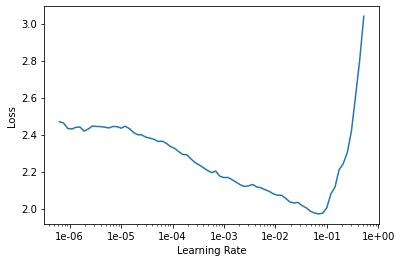

In [ ]:
# Run learning rate finder
import warnings
warnings.filterwarnings('ignore')
learn.lr_find()
learn.recorder.plot()

In [ ]:
# run fit one cycle, learning rate in the slice parameter should be specified, 
#so the middle point of the rate is where the curve falls the most.
learn.fit_one_cycle(6, slice(1e-5,1e-3))

epoch,train_loss,valid_loss,accuracy,time
0,1.865147,1.090707,0.612500,00:27
1,1.618763,1.134542,0.614062,00:27
2,1.456967,0.929179,0.654688,00:27
3,1.257656,0.882216,0.648438,00:28
4,1.112377,0.884264,0.662500,00:28
5,1.014253,0.889519,0.664062,00:27


In [ ]:
#quicksave the model, note this does not export your model.
learn.save('Stage-1-1')

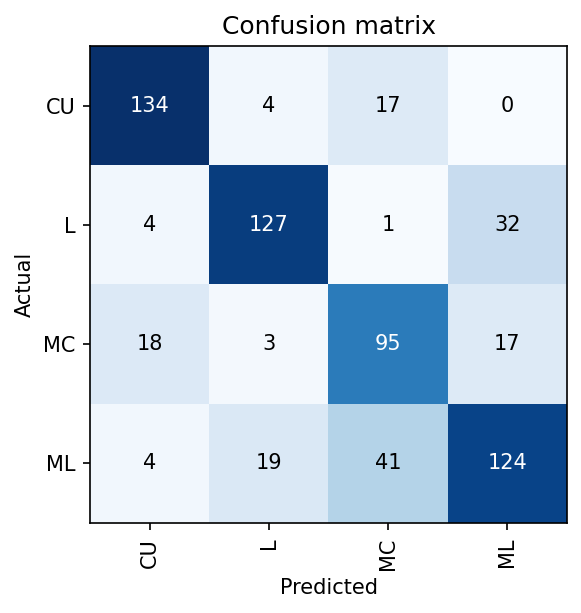

In [ ]:
learn.load('Stage-1-1');
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(dpi = 150)

In [ ]:
#mappa specifies the folder where the test images are.
mappa=('./Upload_film/')

In [ ]:
# change directory to the folder
%cd /content/drive/MyDrive/Upload_film/

/content/drive/MyDrive/Upload_film


In [ ]:
# get the jpegs
import glob
lst = glob.glob('./*.jpg')

In [ ]:
len(lst)

149

In [ ]:
# create an empty list for the results
fastai1_eredmeny = []
fastai1_return = []

In [ ]:
# make sure to cd to the right folder where your files are
%cd /content/drive/MyDrive/Upload_film/

/content/drive/MyDrive/Upload_film


In [ ]:
# import the required packages
import os
import cv2
import matplotlib.pyplot as plt
from PIL import *
import PIL.Image

In [ ]:
import warnings
warnings.filterwarnings('ignore')
# run predictions for each files
for file in lst:
  #load image, predict and append the empty list.
    img = open_image(file)
    prediction1 = str(learn.predict(img)[0])
    fastai1_return.append(prediction1)
    # print out the prediction and show the image predicted
    print(f'FastAI Plán eredmény: {prediction1}')
    img_path=os.path.join(mappa,file)
    img_array=img = cv2.imread(img_path,cv2.COLOR_BGR2RGB)
    plt.imshow(cv2.cvtColor(img_array, cv2.COLOR_BGR2RGB))
    plt.show()


In [ ]:
# import the correct solutions for the testing dataset. Append their values to the solutions list.
solutions = []
import csv

with open('/content/drive/MyDrive/Marton Mátyás szakdolgozat programok/solutions1.csv', newline='') as f:
    reader = csv.reader(f)
    for i in reader:
      solutions.append(i)

In [ ]:
# Create a dataframe from the solutions. Add a column of Correct answers based on matching predictions.
import pandas as pd
df = pd.DataFrame(list(zip(lst,fastai1_return,solutions)), columns = ['Filename','Fast.AI Prediction','Correct Answer'])
df['Correct Answer'] =  df['Correct Answer'].str[0]
df['Score'] = df['Fast.AI Prediction'] == df['Correct Answer']
df['Score'] = df['Score'].astype(int)

df

,Filename,Fast.AI Prediction,Correct Answer,Score
0,./Pretty.Woman.1990.720p.BluRay.x264.YIFY-Scen...,CU,CU,1
1,./Pretty.Woman.1990.720p.BluRay.x264.YIFY-Scen...,ML,ML,1
2,./bo.burnham.inside.2021.720p.web.h264-naisu-S...,CU,CU,1
3,./bo.burnham.inside.2021.720p.web.h264-naisu-S...,CU,CU,1
4,./bo.burnham.inside.2021.720p.web.h264-naisu-S...,CU,MC,0
...,...,...,...,...
144,./FeleségemTörténete-Scene-017-01.jpg,L,L,1
145,./FeleségemTörténete-Scene-019-03.jpg,ML,L,0
146,./FeleségemTörténete-Scene-020-01.jpg,CU,CU,1
147,./FeleségemTörténete-Scene-034-01.jpg,L,L,1


In [ ]:
# Calculate the accuracy
model_score = df['Score'].sum()
all_images = len(df['Score'])
endresult = model_score/all_images

print(f'Accuracy = {endresult * 100}%')
# Note: the testing dataset here is biased towards Close Ups. 

Accuracy = 73.8255033557047%


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


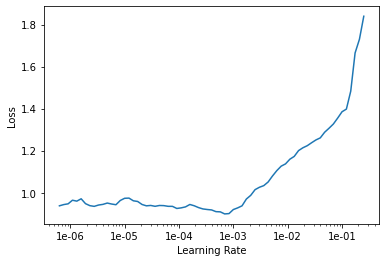

In [ ]:
# Unfreeze the model so you can train on all the layers.
# Find the new learning rate.
learn.unfreeze()
learn.lr_find()
learn.recorder.plot()

In [ ]:
# Find the learning section on the graph where the rate stays constant, or keeps going down.
learn.fit_one_cycle(6, slice(1e-5,1e-4))

epoch,train_loss,valid_loss,accuracy,time
0,0.869499,0.823809,0.689062,00:37
1,0.835513,0.738839,0.707812,00:36
2,0.768422,0.764472,0.723437,00:37
3,0.713461,0.722296,0.734375,00:37
4,0.639585,0.725038,0.735937,00:36
5,0.588863,0.707378,0.735937,00:36


In [ ]:
# Save the model.
learn.save('Stage-1-2')

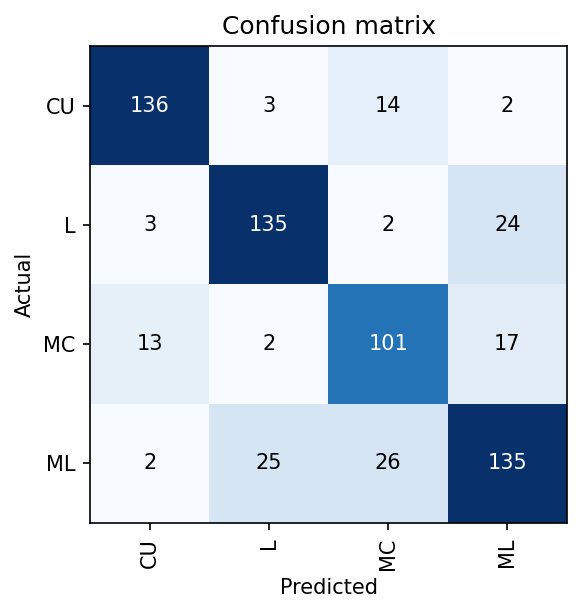

In [ ]:
learn.load('Stage-1-2');
#learn = learn.to_fp32()
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(dpi = 150)

In [ ]:
# Create a new empty list, to run new tests.
fastai2_eredmeny = []
fastai2_return = []

FastAI Plán eredmény: CU


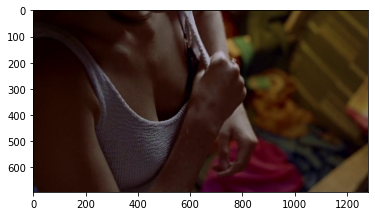

FastAI Plán eredmény: ML


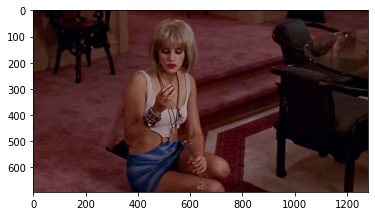

FastAI Plán eredmény: CU


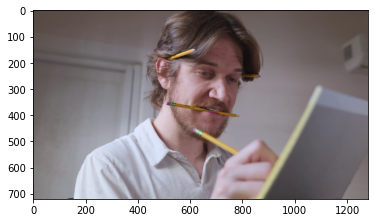

FastAI Plán eredmény: CU


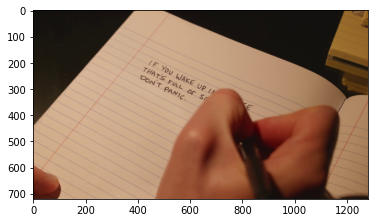

FastAI Plán eredmény: CU


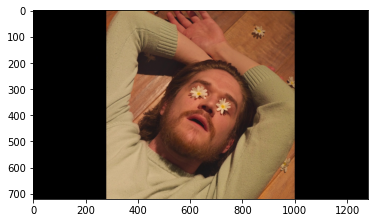

FastAI Plán eredmény: ML


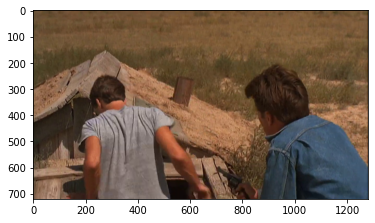

FastAI Plán eredmény: L


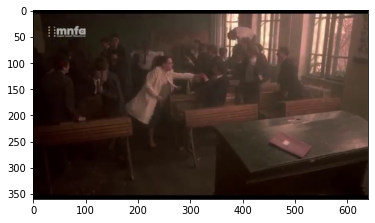

FastAI Plán eredmény: ML


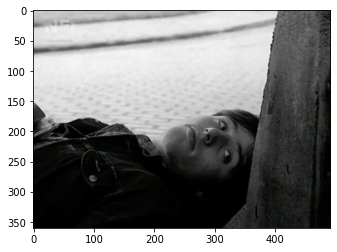

FastAI Plán eredmény: ML


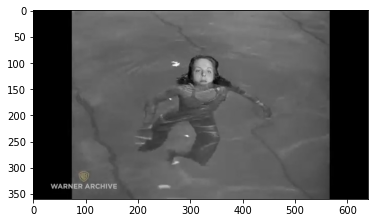

FastAI Plán eredmény: MC


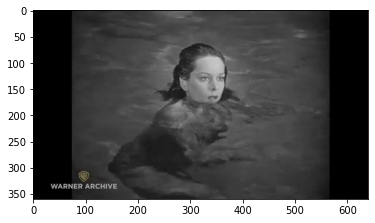

FastAI Plán eredmény: CU


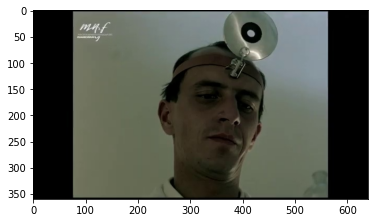

FastAI Plán eredmény: L


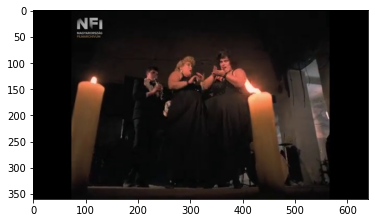

FastAI Plán eredmény: MC


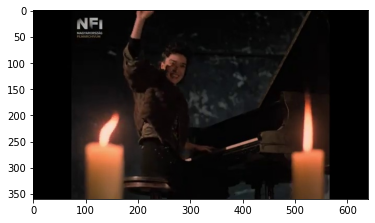

FastAI Plán eredmény: CU


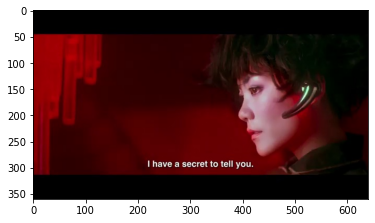

FastAI Plán eredmény: CU


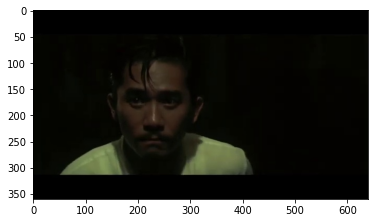

FastAI Plán eredmény: L


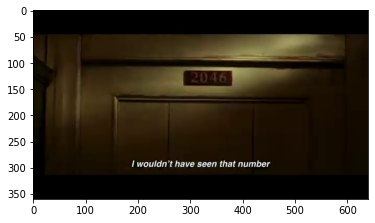

FastAI Plán eredmény: CU


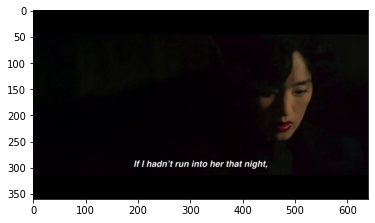

FastAI Plán eredmény: ML


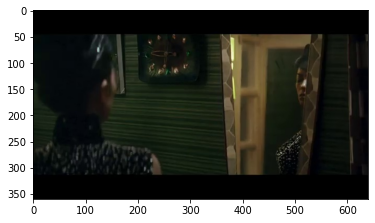

FastAI Plán eredmény: CU


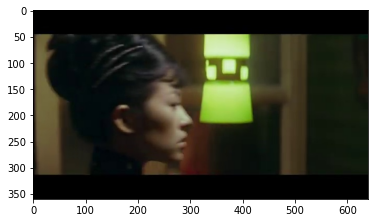

FastAI Plán eredmény: CU


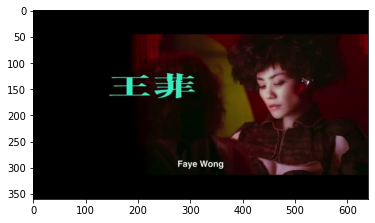

FastAI Plán eredmény: ML


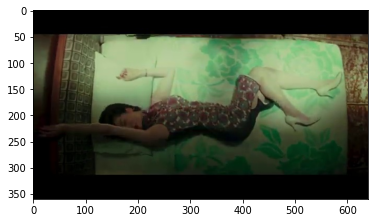

FastAI Plán eredmény: L


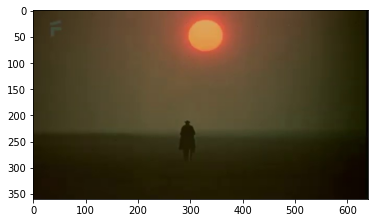

FastAI Plán eredmény: CU


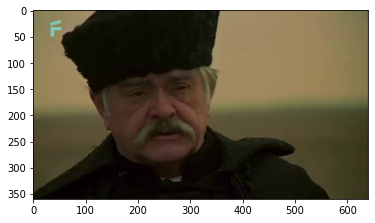

FastAI Plán eredmény: L


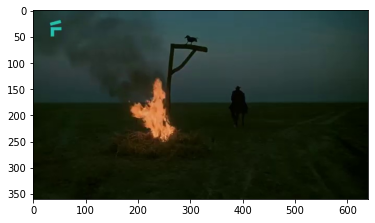

FastAI Plán eredmény: MC


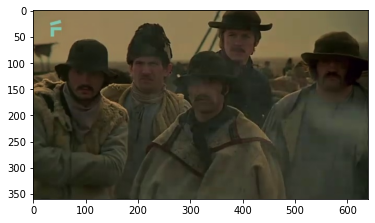

FastAI Plán eredmény: CU


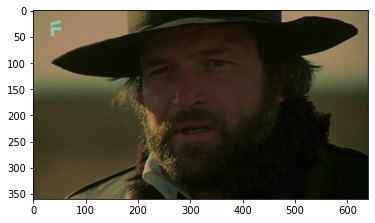

FastAI Plán eredmény: L


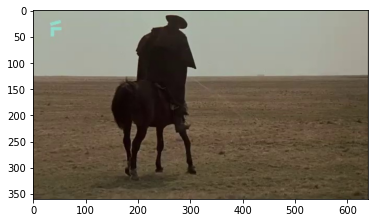

FastAI Plán eredmény: ML


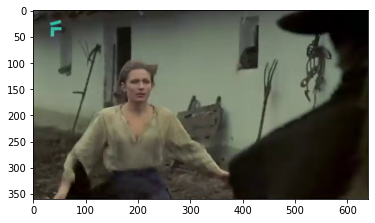

FastAI Plán eredmény: CU


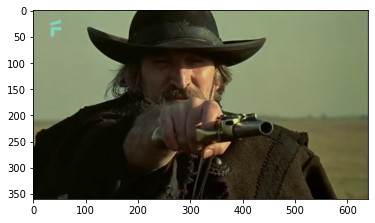

FastAI Plán eredmény: CU


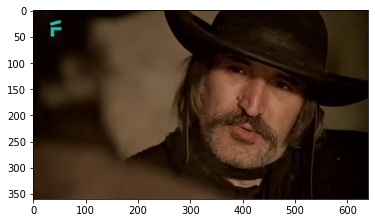

FastAI Plán eredmény: CU


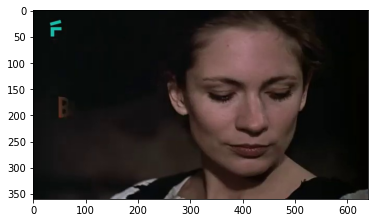

FastAI Plán eredmény: ML


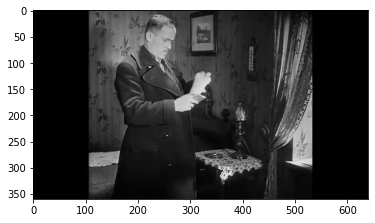

FastAI Plán eredmény: CU


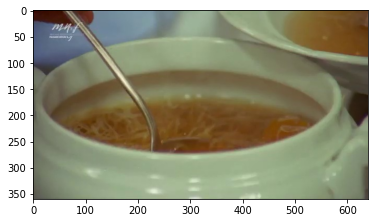

FastAI Plán eredmény: L


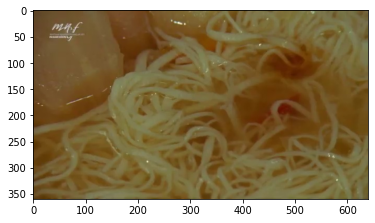

FastAI Plán eredmény: CU


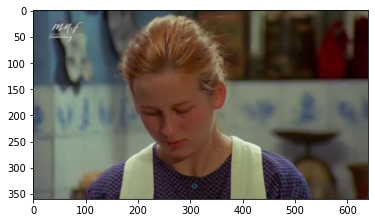

FastAI Plán eredmény: ML


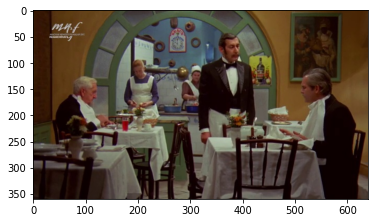

FastAI Plán eredmény: CU


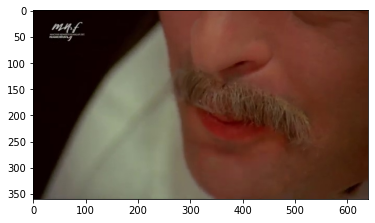

FastAI Plán eredmény: CU


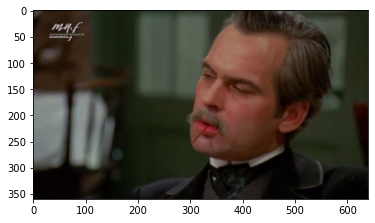

FastAI Plán eredmény: ML


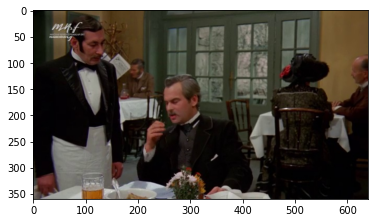

FastAI Plán eredmény: MC


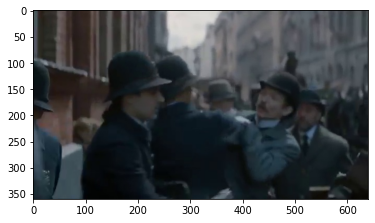

FastAI Plán eredmény: L


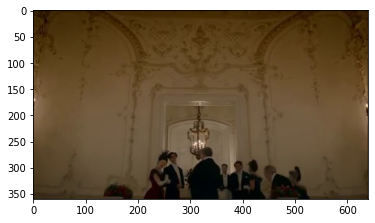

FastAI Plán eredmény: ML


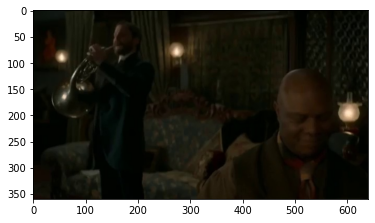

FastAI Plán eredmény: CU


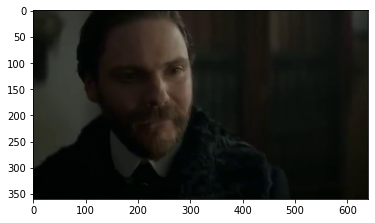

FastAI Plán eredmény: CU


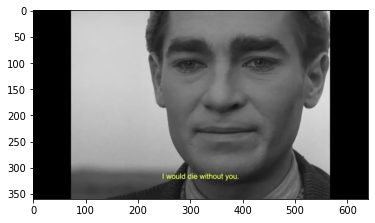

FastAI Plán eredmény: CU


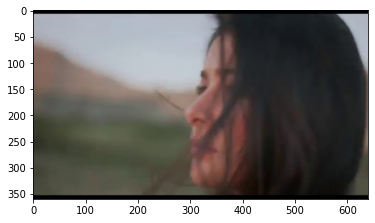

FastAI Plán eredmény: MC


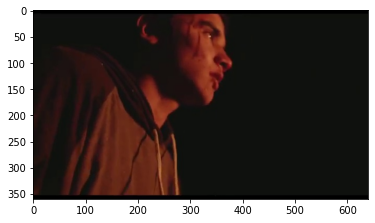

FastAI Plán eredmény: L


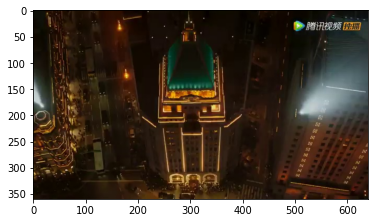

FastAI Plán eredmény: CU


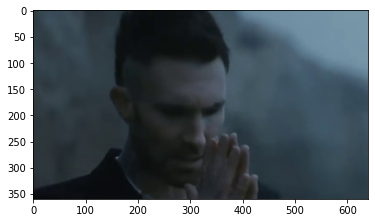

FastAI Plán eredmény: L


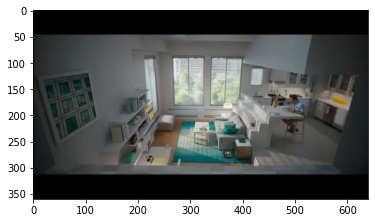

FastAI Plán eredmény: MC


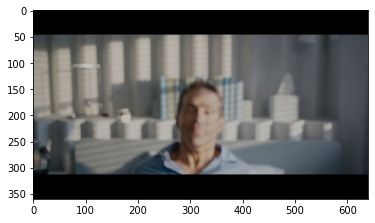

FastAI Plán eredmény: MC


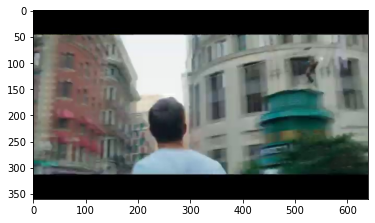

FastAI Plán eredmény: CU


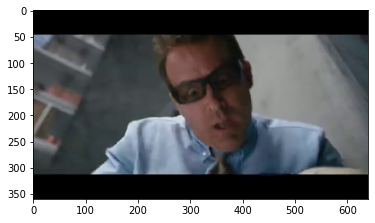

FastAI Plán eredmény: MC


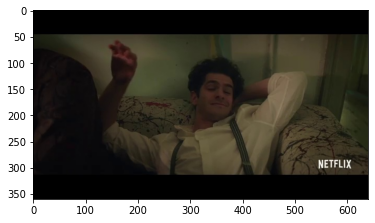

FastAI Plán eredmény: MC


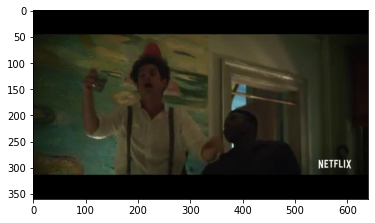

FastAI Plán eredmény: ML


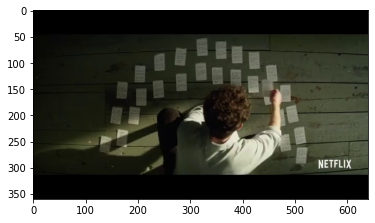

FastAI Plán eredmény: MC


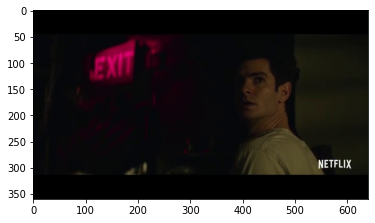

FastAI Plán eredmény: CU


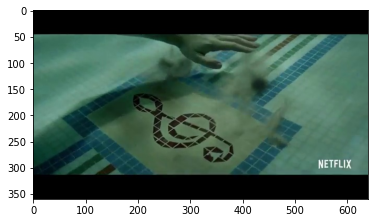

FastAI Plán eredmény: MC


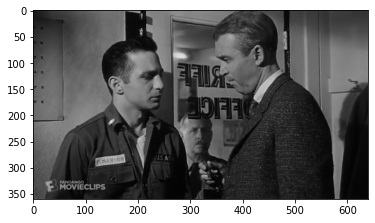

FastAI Plán eredmény: CU


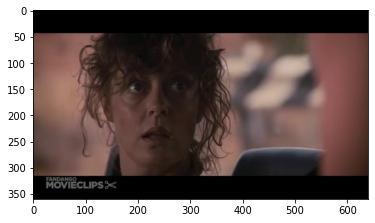

FastAI Plán eredmény: CU


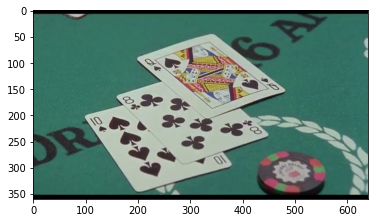

FastAI Plán eredmény: CU


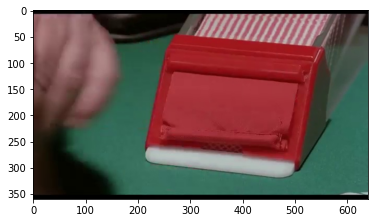

FastAI Plán eredmény: CU


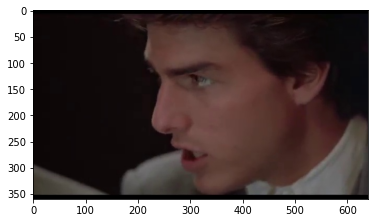

FastAI Plán eredmény: L


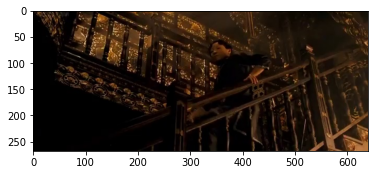

FastAI Plán eredmény: CU


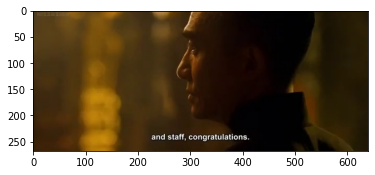

FastAI Plán eredmény: CU


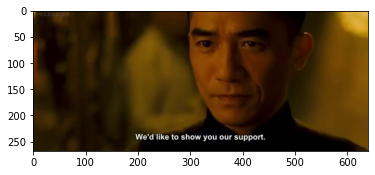

FastAI Plán eredmény: L


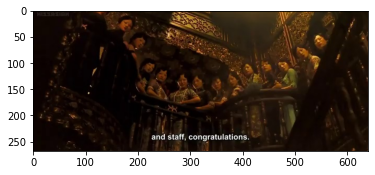

FastAI Plán eredmény: ML


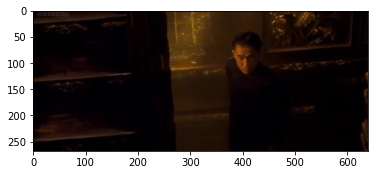

FastAI Plán eredmény: ML


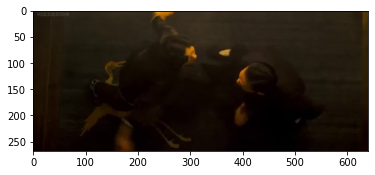

FastAI Plán eredmény: CU


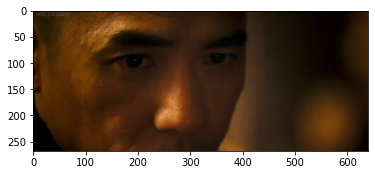

FastAI Plán eredmény: CU


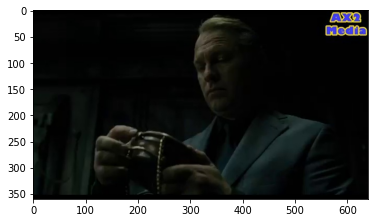

FastAI Plán eredmény: MC


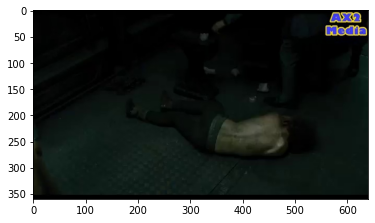

FastAI Plán eredmény: MC


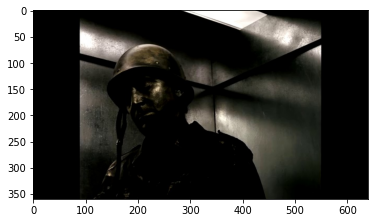

FastAI Plán eredmény: CU


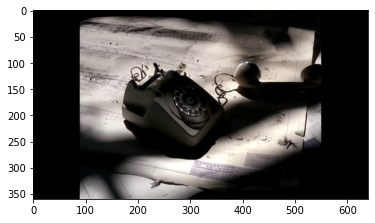

FastAI Plán eredmény: ML


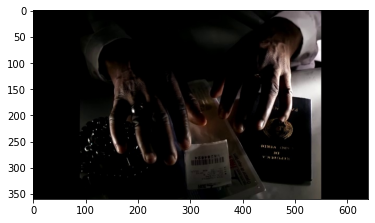

FastAI Plán eredmény: ML


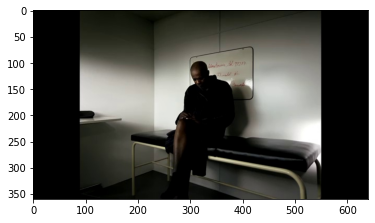

FastAI Plán eredmény: CU


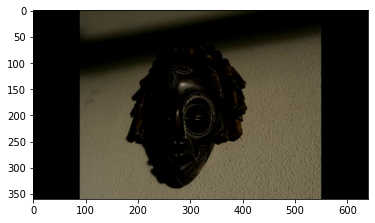

FastAI Plán eredmény: CU


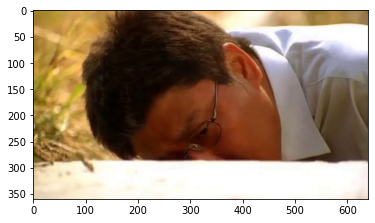

FastAI Plán eredmény: ML


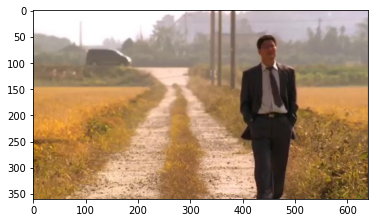

FastAI Plán eredmény: MC


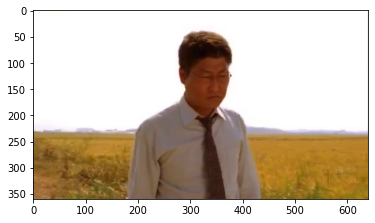

FastAI Plán eredmény: L


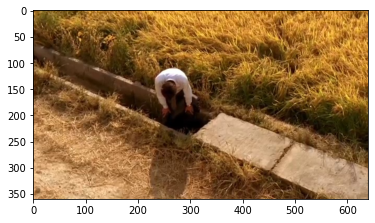

FastAI Plán eredmény: L


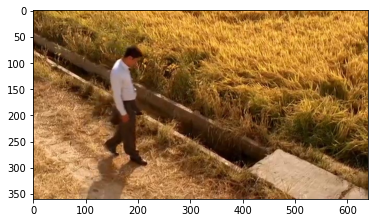

FastAI Plán eredmény: CU


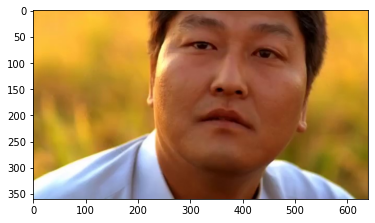

FastAI Plán eredmény: CU


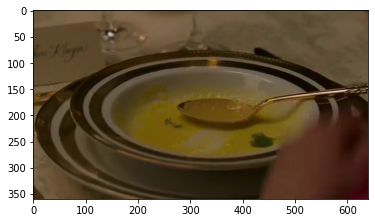

FastAI Plán eredmény: CU


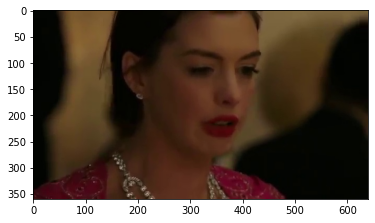

FastAI Plán eredmény: CU


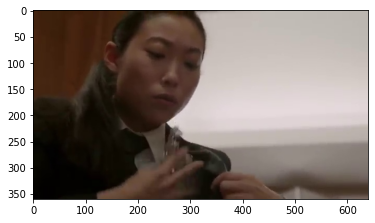

FastAI Plán eredmény: MC


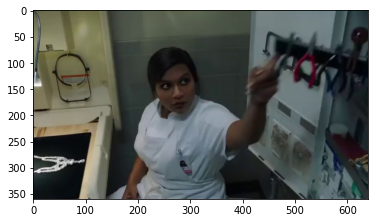

FastAI Plán eredmény: L


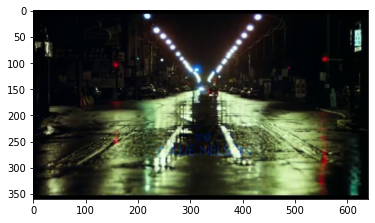

FastAI Plán eredmény: L


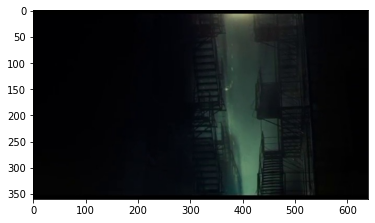

FastAI Plán eredmény: CU


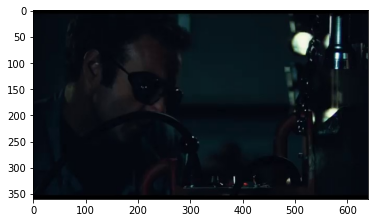

FastAI Plán eredmény: CU


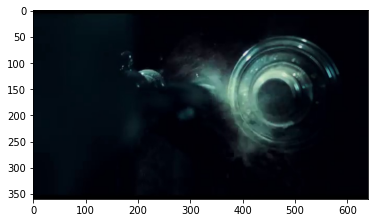

FastAI Plán eredmény: ML


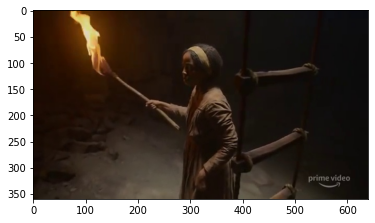

FastAI Plán eredmény: MC


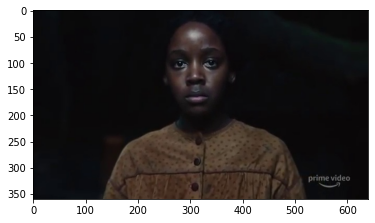

FastAI Plán eredmény: L


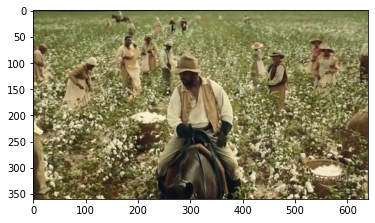

FastAI Plán eredmény: MC


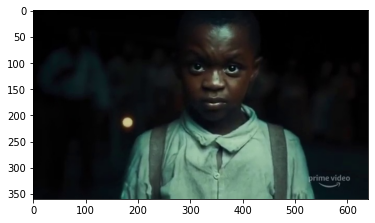

FastAI Plán eredmény: CU


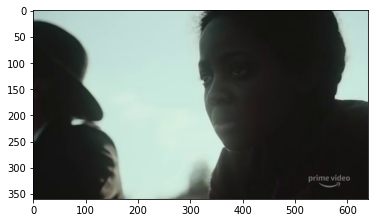

FastAI Plán eredmény: ML


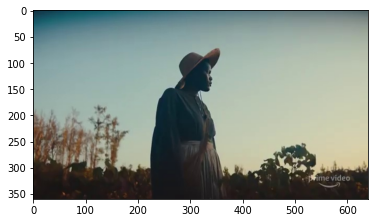

FastAI Plán eredmény: MC


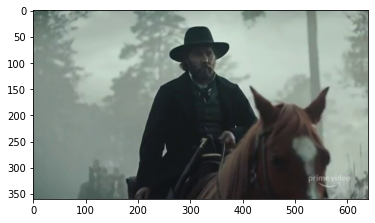

FastAI Plán eredmény: CU


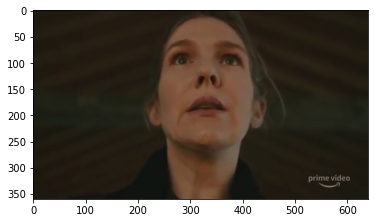

FastAI Plán eredmény: CU


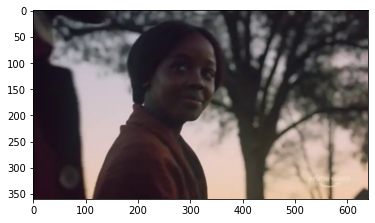

FastAI Plán eredmény: L


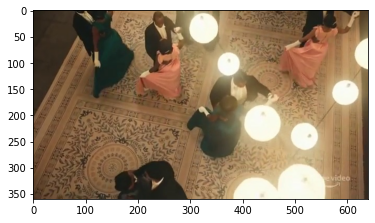

FastAI Plán eredmény: L


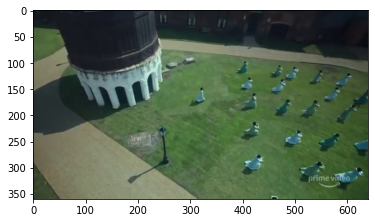

FastAI Plán eredmény: MC


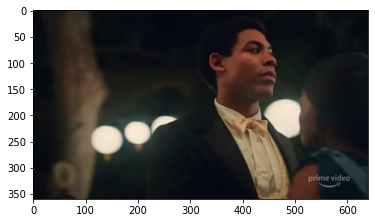

FastAI Plán eredmény: ML


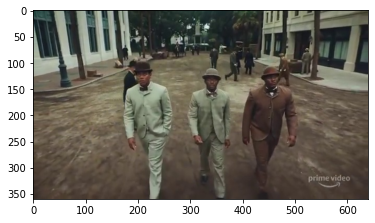

FastAI Plán eredmény: CU


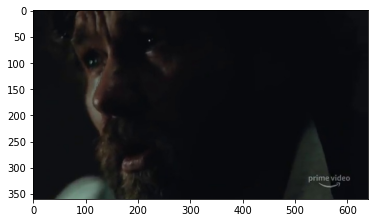

FastAI Plán eredmény: MC


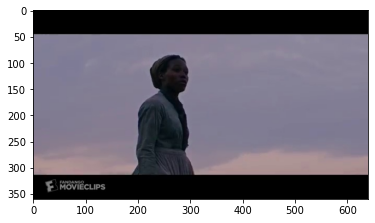

FastAI Plán eredmény: MC


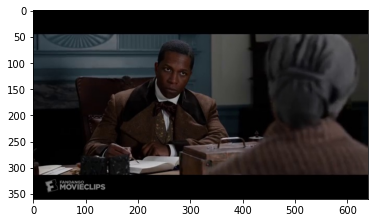

FastAI Plán eredmény: ML


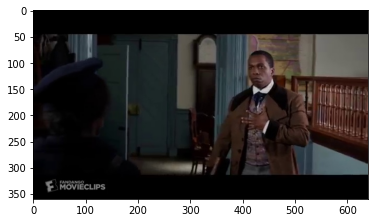

FastAI Plán eredmény: ML


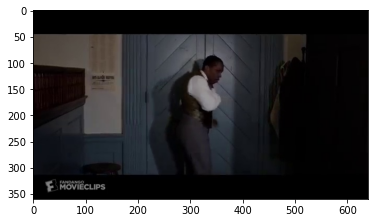

FastAI Plán eredmény: MC


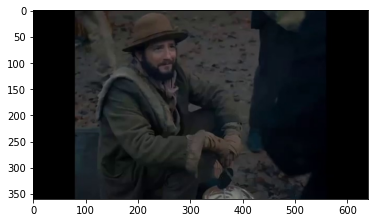

FastAI Plán eredmény: ML


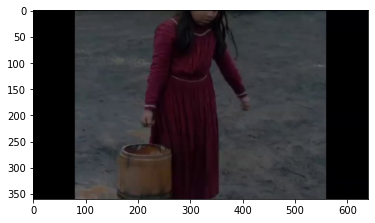

FastAI Plán eredmény: L


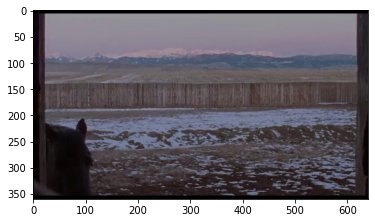

FastAI Plán eredmény: ML


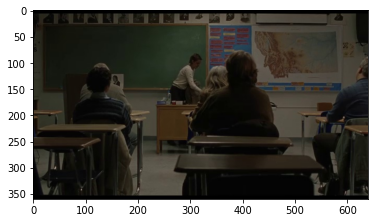

FastAI Plán eredmény: MC


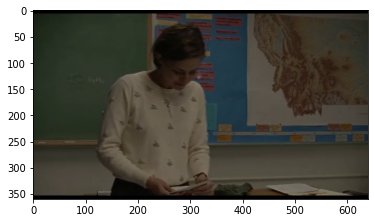

FastAI Plán eredmény: ML


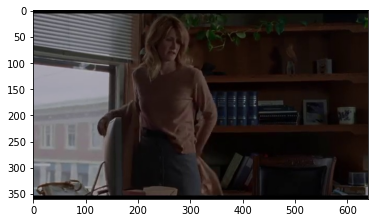

FastAI Plán eredmény: ML


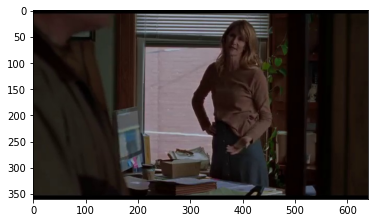

FastAI Plán eredmény: ML


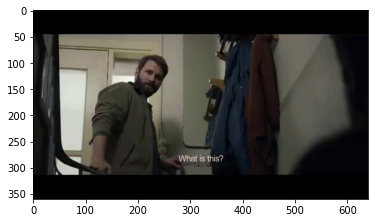

FastAI Plán eredmény: CU


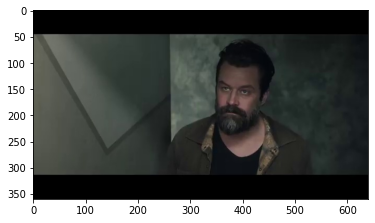

FastAI Plán eredmény: CU


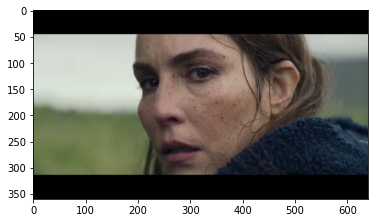

FastAI Plán eredmény: CU


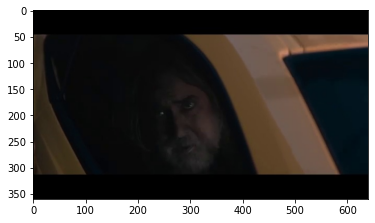

In [ ]:
import warnings
warnings.filterwarnings('ignore')
for file in lst:
    img = open_image(file)
    prediction1 = str(learn.predict(img)[0])
    fastai2_return.append(prediction1)
    print(f'FastAI Plán eredmény: {prediction1}')
    img_path=os.path.join(mappa,file)
    img_array=img = cv2.imread(img_path,cv2.COLOR_BGR2RGB)
    plt.imshow(cv2.cvtColor(img_array, cv2.COLOR_BGR2RGB))
    plt.show()


In [ ]:
import pandas as pd
df2 = pd.DataFrame(list(zip(lst,fastai2_return,solutions)), columns = ['Filename','Fast.AI Prediction','Correct Answer'])
df2['Correct Answer'] =  df2['Correct Answer'].str[0]
df2['Score'] = df2['Fast.AI Prediction'] == df2['Correct Answer']
df2['Score'] = df2['Score'].astype(int)
df2

In [ ]:
model_score2 = df2['Score'].sum()
all_images2 = len(df2['Score'])
endresult2 = model_score2/all_images2

print(f'Accuracy = {endresult2 * 100}%')

Accuracy = 85.90604026845638%


In [ ]:
# Since the model scored really high, we export it to a pkl file. This file can be loaded and imported for deployment.
learn.export()

In [ ]:
# Place the exported file to a directory
source = r'/content/export.pkl'
dest = r'/content/drive/MyDrive/Marton Mátyás szakdolgozat programok/models/3200ShotType_85pct'
shutil.move(source,dest)

'/content/drive/MyDrive/Marton Mátyás szakdolgozat programok/models/3200ShotType_85pct/export.pkl'

In [ ]:
# Increase the size of the images
base_size = 75
base_size = base_size * 3

img_size = to_film_ar(base_size)
tfms = get_tfms()

img_size
# Note: I found that increasing size and retraining the model yields no better results.

(225, 400)

In [ ]:
# Load the new data
data = ImageDataBunch.from_folder(path, train='.', valid_pct=0.2,
                                  size=img_size, ds_tfms=tfms, bs=bs, resize_method=ResizeMethod.SQUISH, num_workers=4).normalize(imagenet_stats)

In [ ]:
# freeze the model to train on the top layer, also to_fp32 means we train only using the CPU.
#learn.load('Stage-1-2')
learn = learn.to_fp32()
learn.freeze()
# use the new data
learn.data = data

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


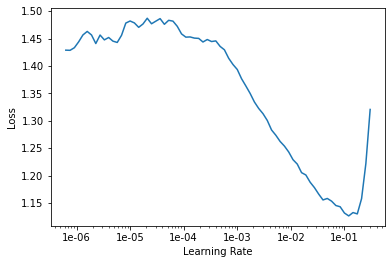

In [ ]:
# Find new learning rate.
learn.lr_find()
learn.recorder.plot()

In [ ]:
# train again, set the max learing rete at the steepest point of decline on the graph.
learn.fit_one_cycle(6, max_lr = slice(1e-2))

epoch,train_loss,valid_loss,accuracy,time
0,1.015830,0.685289,0.745313,01:27
1,0.790200,0.561678,0.778125,01:25
2,0.676231,0.522791,0.796875,01:24
3,0.613084,0.490647,0.812500,01:24
4,0.558421,0.451130,0.817187,01:24
5,0.536042,0.463132,0.820312,01:24


In [ ]:
learn.save('Stage-2-1')

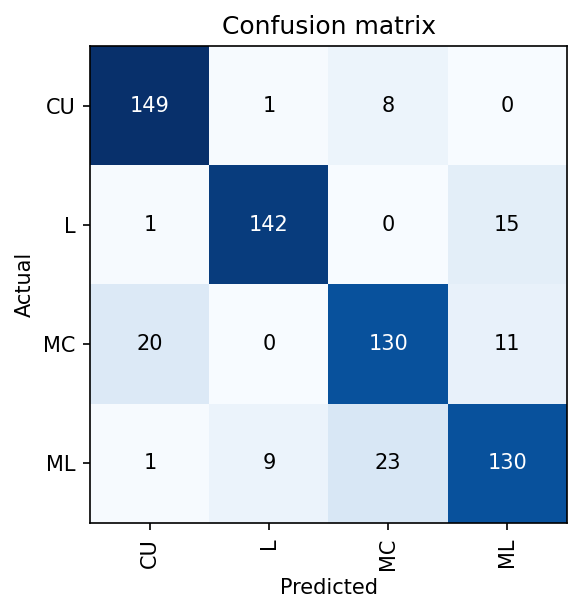

In [ ]:

learn.load('Stage-2-1');
learn = learn.to_fp32()
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(dpi = 150)

In [ ]:
# Create new empty lists
fastai3_eredmeny = []
fastai3_return = []

FastAI Plán eredmény: CU


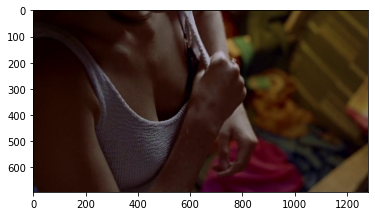

FastAI Plán eredmény: MC


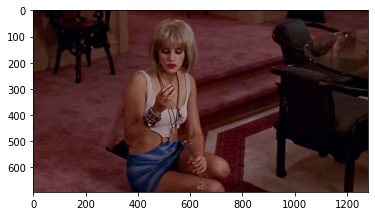

FastAI Plán eredmény: MC


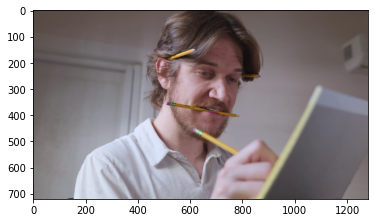

FastAI Plán eredmény: CU


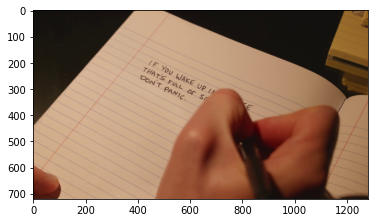

FastAI Plán eredmény: CU


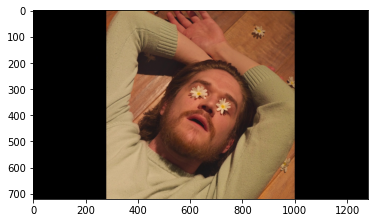

FastAI Plán eredmény: ML


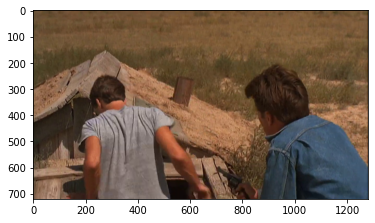

FastAI Plán eredmény: L


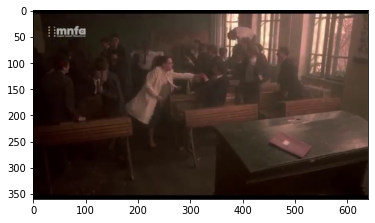

FastAI Plán eredmény: CU


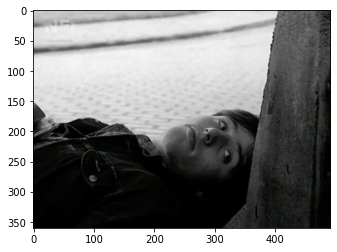

FastAI Plán eredmény: ML


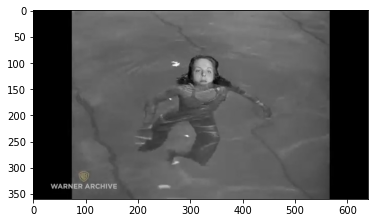

FastAI Plán eredmény: MC


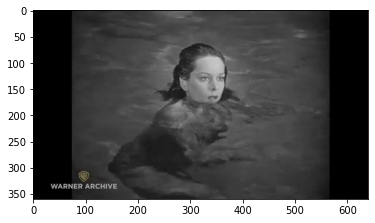

FastAI Plán eredmény: CU


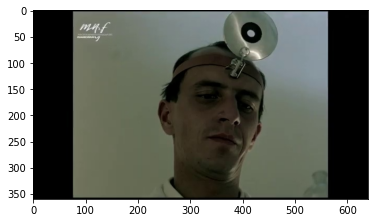

FastAI Plán eredmény: L


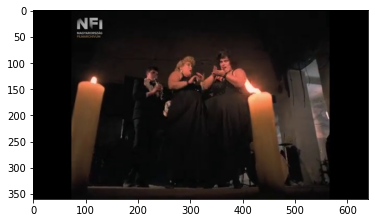

FastAI Plán eredmény: ML


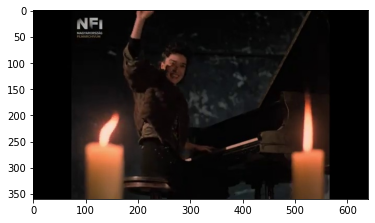

FastAI Plán eredmény: CU


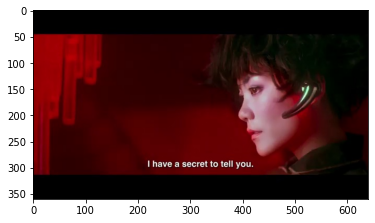

FastAI Plán eredmény: CU


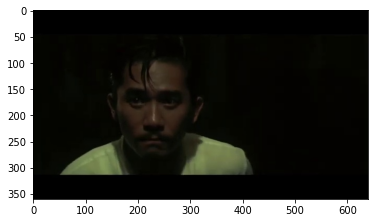

FastAI Plán eredmény: L


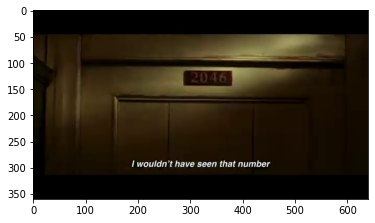

FastAI Plán eredmény: CU


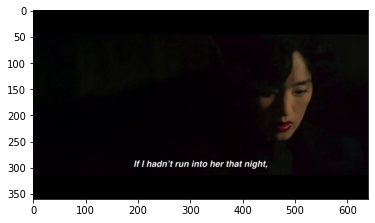

FastAI Plán eredmény: L


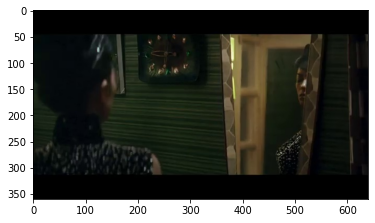

FastAI Plán eredmény: CU


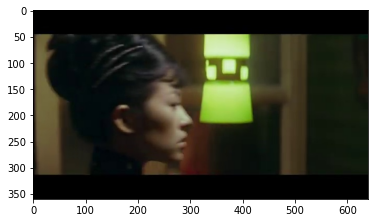

FastAI Plán eredmény: MC


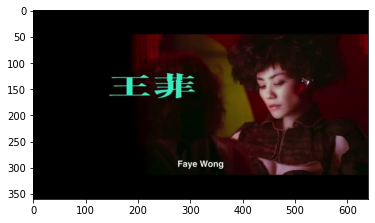

FastAI Plán eredmény: ML


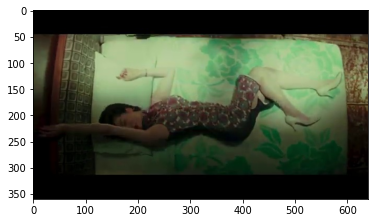

FastAI Plán eredmény: L


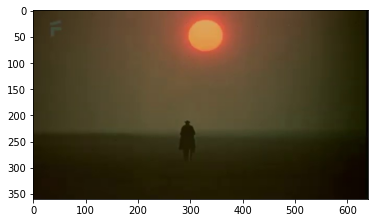

FastAI Plán eredmény: CU


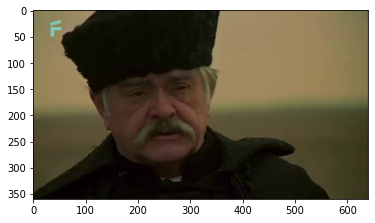

FastAI Plán eredmény: L


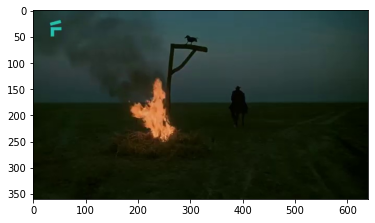

FastAI Plán eredmény: MC


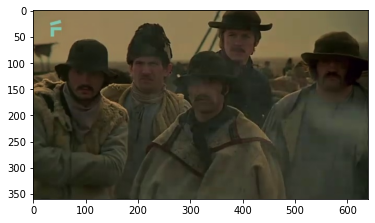

FastAI Plán eredmény: CU


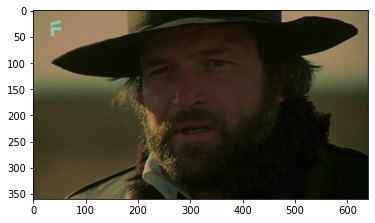

FastAI Plán eredmény: L


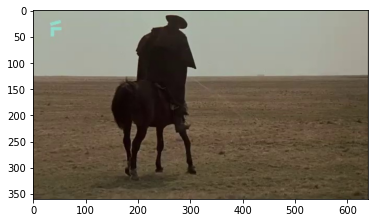

FastAI Plán eredmény: ML


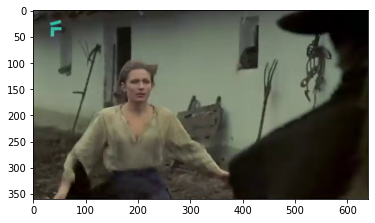

FastAI Plán eredmény: MC


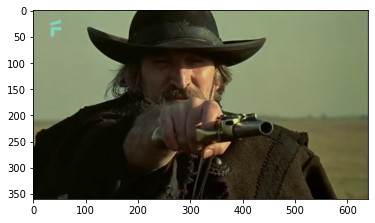

FastAI Plán eredmény: CU


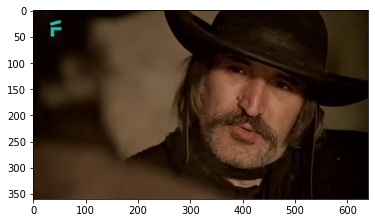

FastAI Plán eredmény: CU


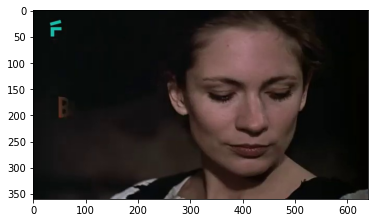

FastAI Plán eredmény: ML


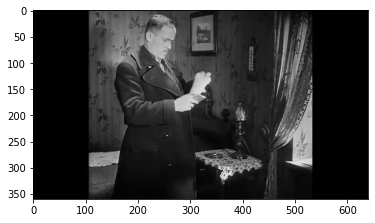

FastAI Plán eredmény: CU


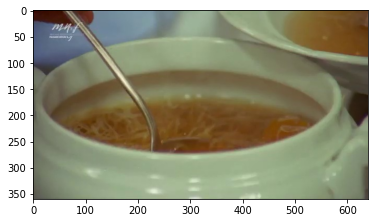

FastAI Plán eredmény: ML


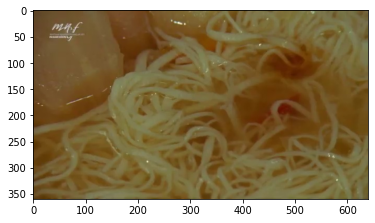

FastAI Plán eredmény: CU


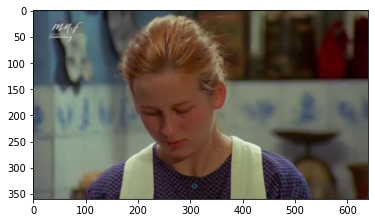

FastAI Plán eredmény: L


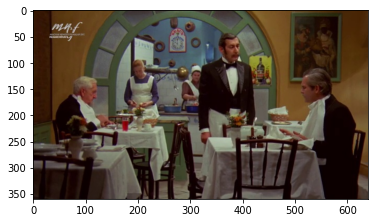

FastAI Plán eredmény: CU


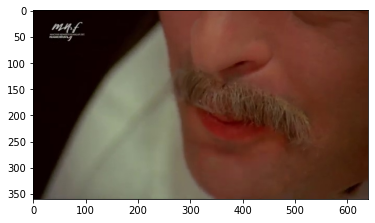

FastAI Plán eredmény: CU


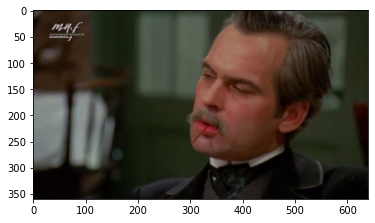

FastAI Plán eredmény: ML


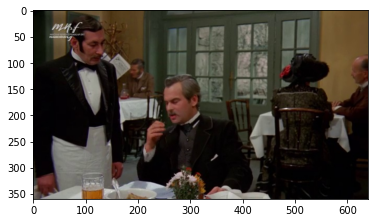

FastAI Plán eredmény: ML


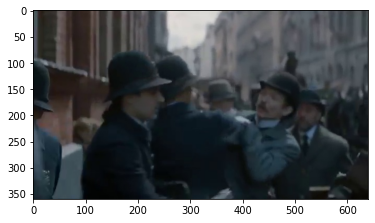

FastAI Plán eredmény: L


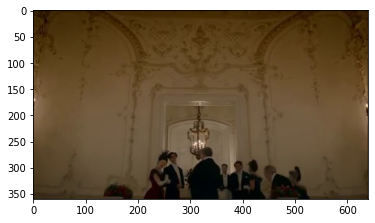

FastAI Plán eredmény: MC


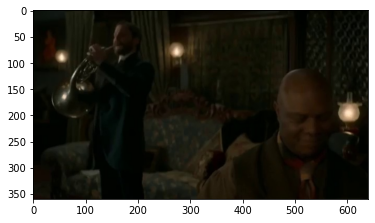

FastAI Plán eredmény: CU


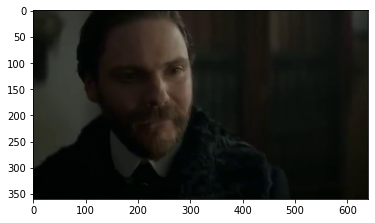

FastAI Plán eredmény: CU


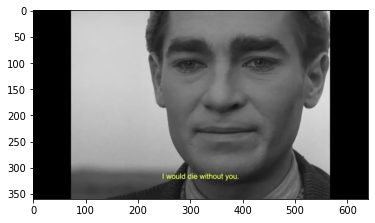

FastAI Plán eredmény: CU


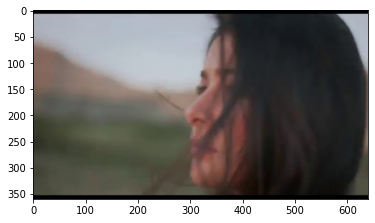

FastAI Plán eredmény: CU


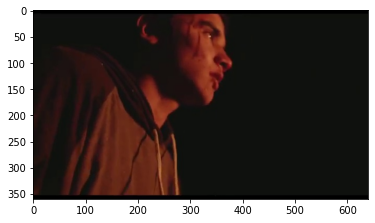

FastAI Plán eredmény: L


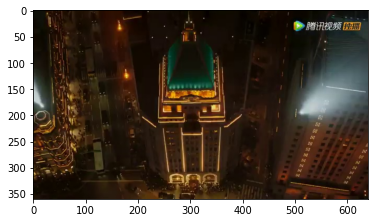

FastAI Plán eredmény: CU


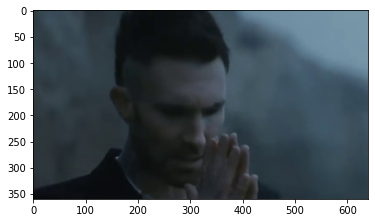

FastAI Plán eredmény: L


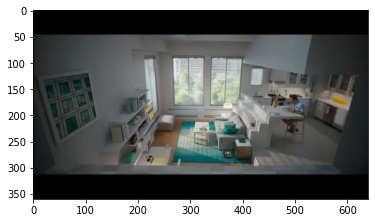

FastAI Plán eredmény: MC


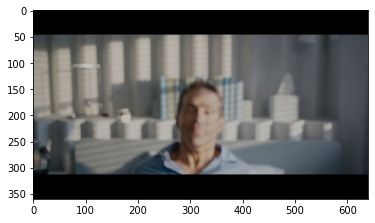

FastAI Plán eredmény: MC


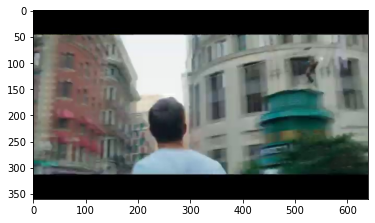

FastAI Plán eredmény: CU


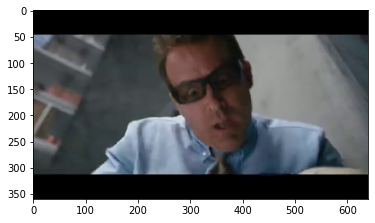

FastAI Plán eredmény: MC


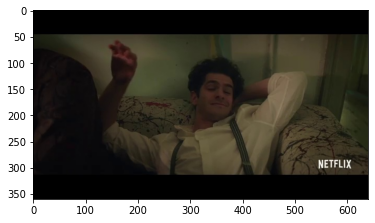

FastAI Plán eredmény: MC


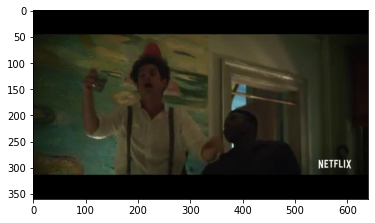

FastAI Plán eredmény: ML


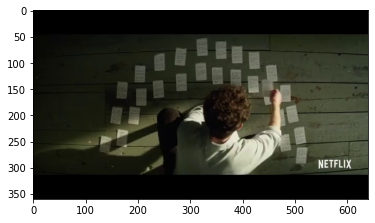

FastAI Plán eredmény: MC


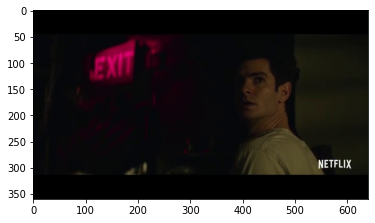

FastAI Plán eredmény: CU


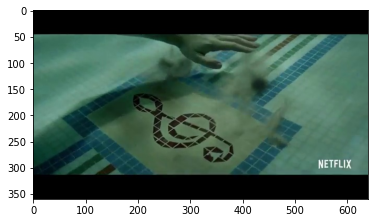

FastAI Plán eredmény: CU


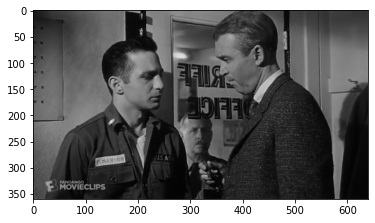

FastAI Plán eredmény: CU


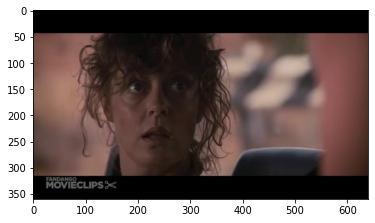

FastAI Plán eredmény: CU


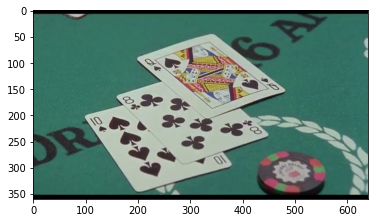

FastAI Plán eredmény: CU


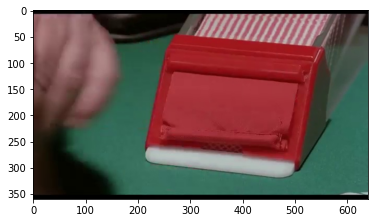

FastAI Plán eredmény: CU


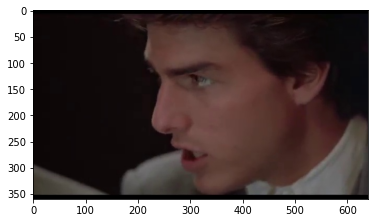

FastAI Plán eredmény: L


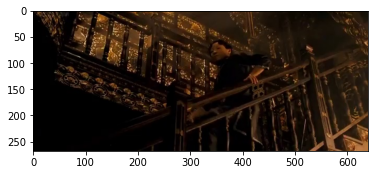

FastAI Plán eredmény: CU


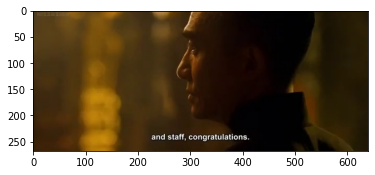

FastAI Plán eredmény: CU


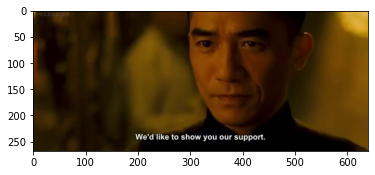

FastAI Plán eredmény: L


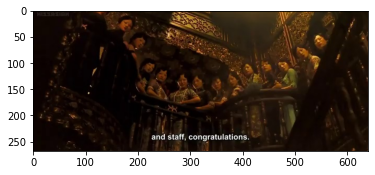

FastAI Plán eredmény: ML


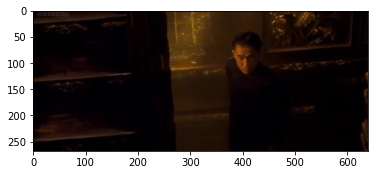

FastAI Plán eredmény: ML


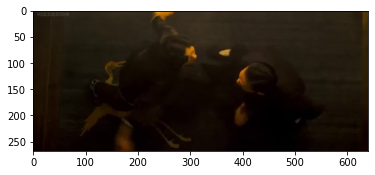

FastAI Plán eredmény: CU


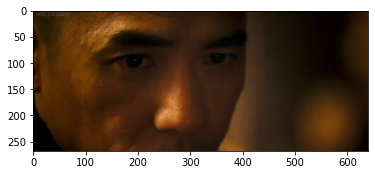

FastAI Plán eredmény: CU


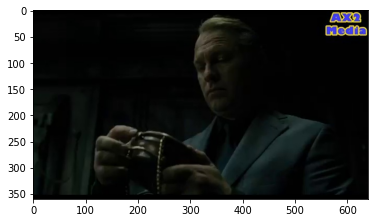

FastAI Plán eredmény: ML


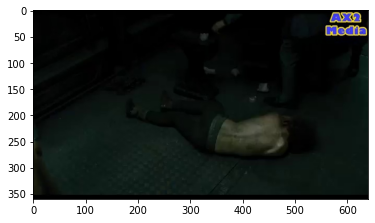

FastAI Plán eredmény: MC


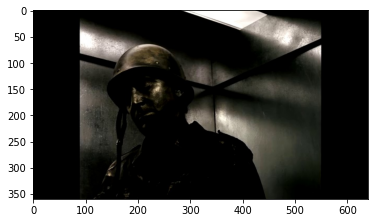

FastAI Plán eredmény: MC


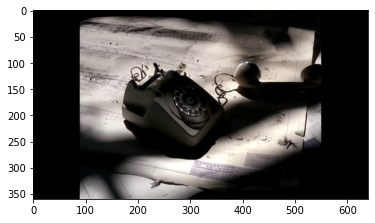

FastAI Plán eredmény: MC


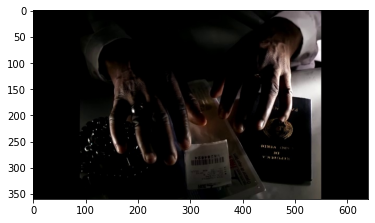

FastAI Plán eredmény: ML


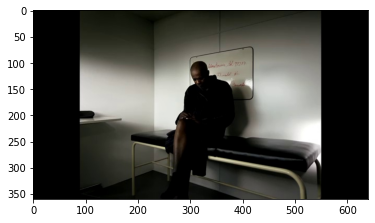

FastAI Plán eredmény: CU


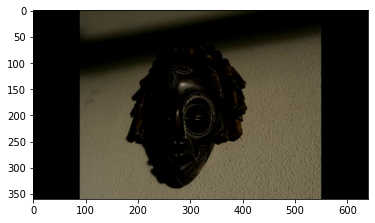

FastAI Plán eredmény: CU


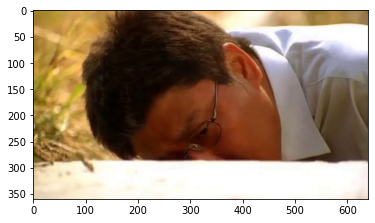

FastAI Plán eredmény: ML


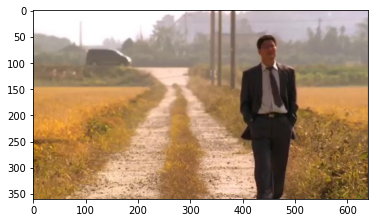

FastAI Plán eredmény: MC


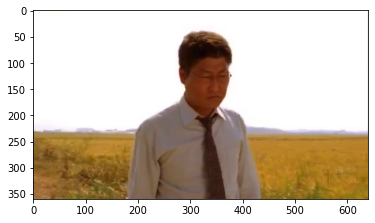

FastAI Plán eredmény: L


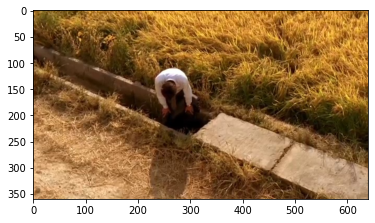

FastAI Plán eredmény: L


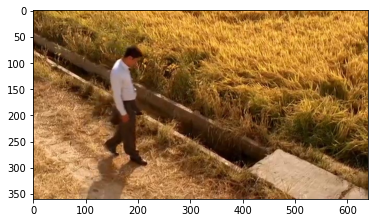

FastAI Plán eredmény: CU


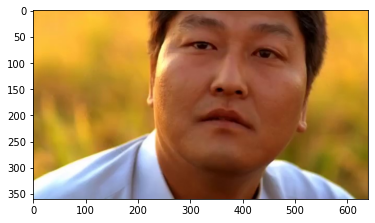

FastAI Plán eredmény: CU


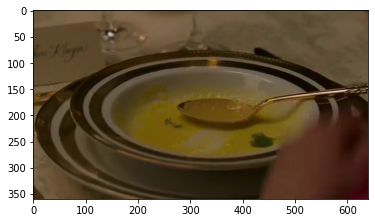

FastAI Plán eredmény: CU


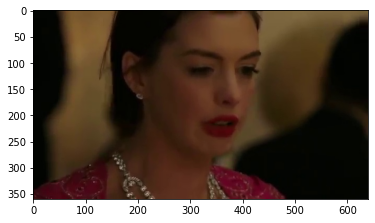

FastAI Plán eredmény: CU


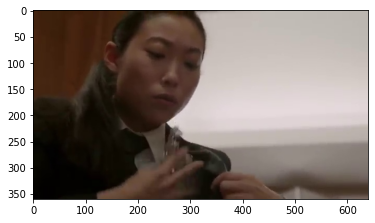

FastAI Plán eredmény: MC


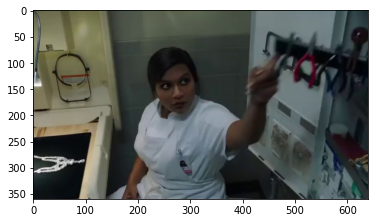

FastAI Plán eredmény: L


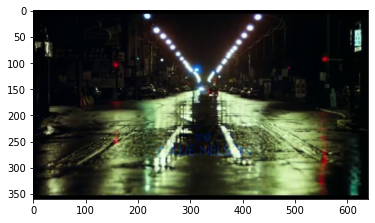

FastAI Plán eredmény: L


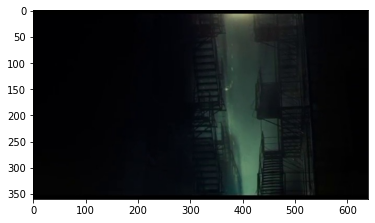

FastAI Plán eredmény: MC


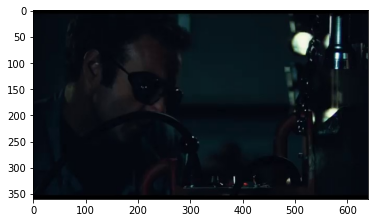

FastAI Plán eredmény: MC


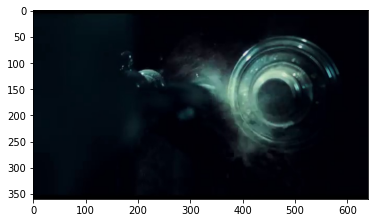

FastAI Plán eredmény: ML


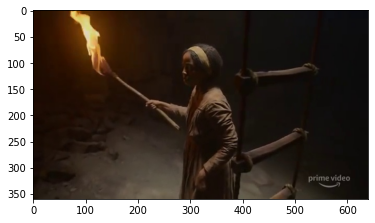

FastAI Plán eredmény: CU


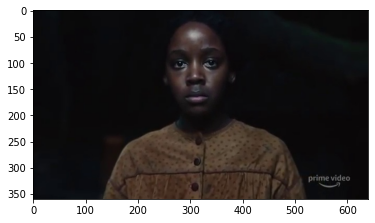

FastAI Plán eredmény: L


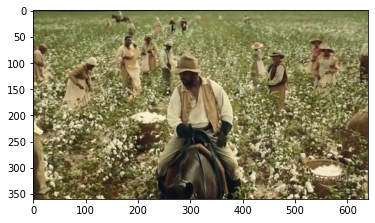

FastAI Plán eredmény: CU


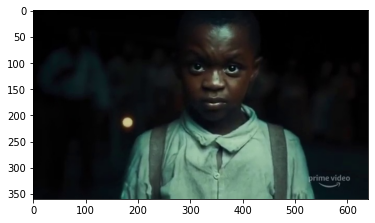

FastAI Plán eredmény: CU


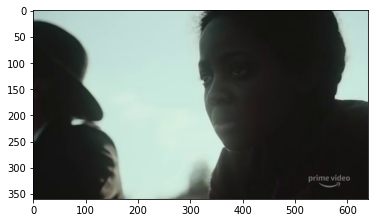

FastAI Plán eredmény: ML


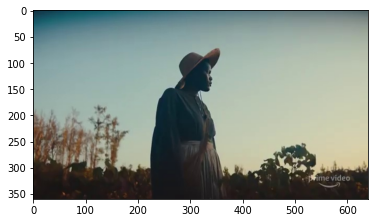

FastAI Plán eredmény: MC


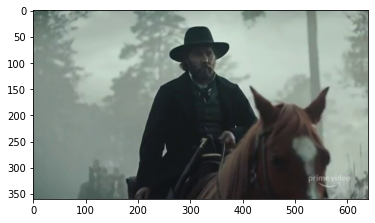

FastAI Plán eredmény: CU


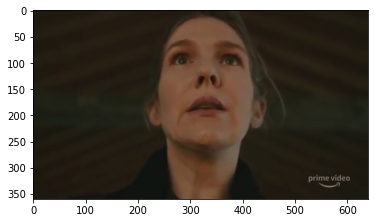

FastAI Plán eredmény: CU


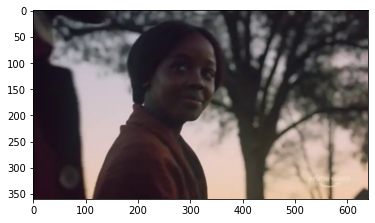

FastAI Plán eredmény: CU


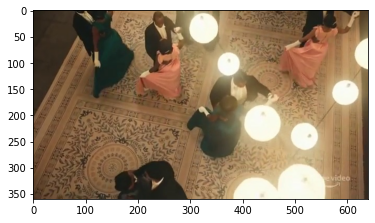

FastAI Plán eredmény: L


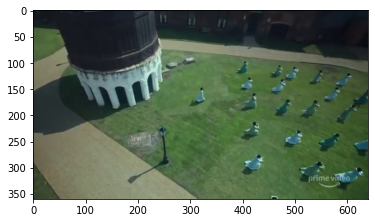

FastAI Plán eredmény: CU


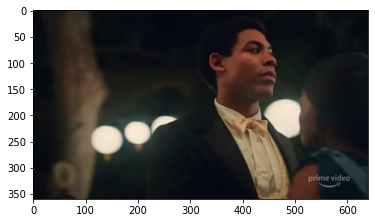

FastAI Plán eredmény: ML


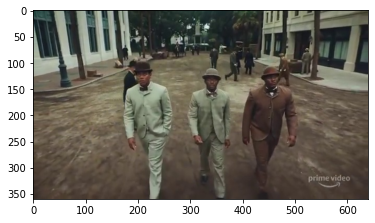

FastAI Plán eredmény: CU


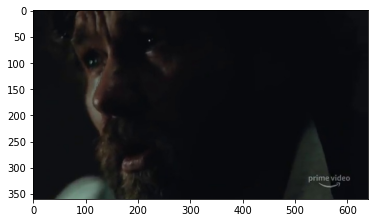

FastAI Plán eredmény: MC


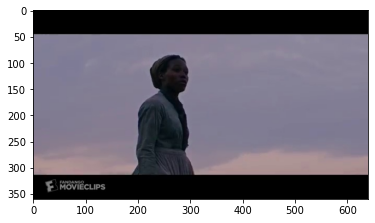

FastAI Plán eredmény: MC


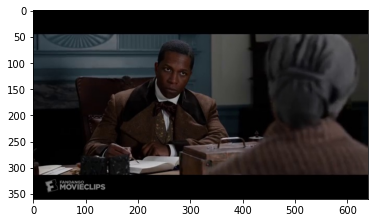

FastAI Plán eredmény: ML


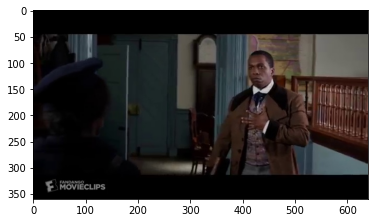

FastAI Plán eredmény: ML


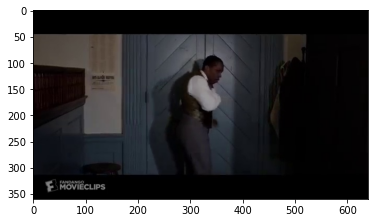

FastAI Plán eredmény: MC


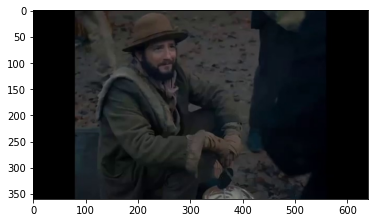

FastAI Plán eredmény: ML


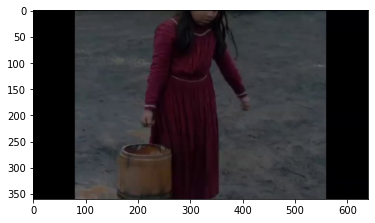

FastAI Plán eredmény: L


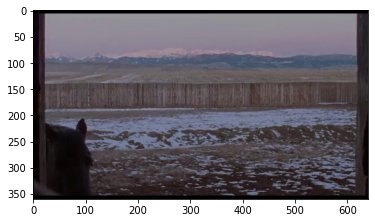

FastAI Plán eredmény: ML


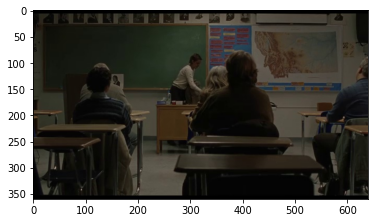

FastAI Plán eredmény: MC


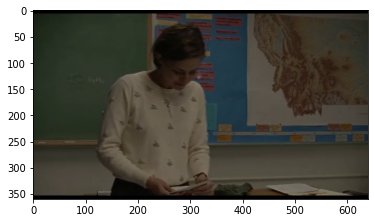

FastAI Plán eredmény: MC


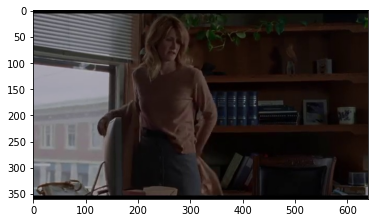

FastAI Plán eredmény: ML


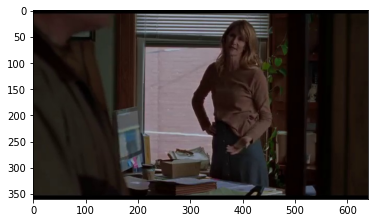

FastAI Plán eredmény: ML


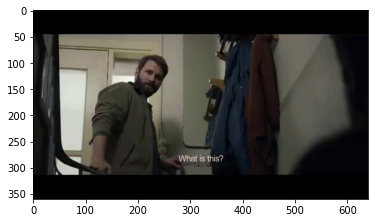

FastAI Plán eredmény: CU


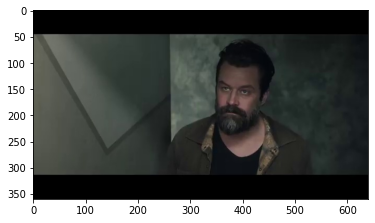

FastAI Plán eredmény: CU


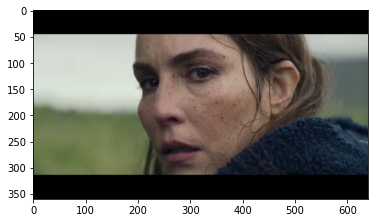

FastAI Plán eredmény: CU


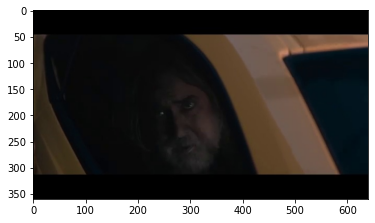

FastAI Plán eredmény: CU


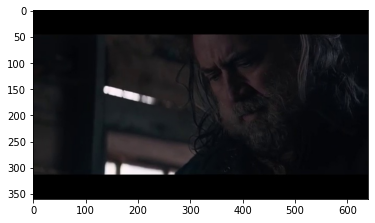

FastAI Plán eredmény: ML


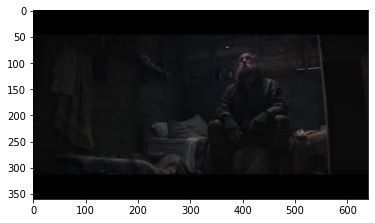

FastAI Plán eredmény: MC


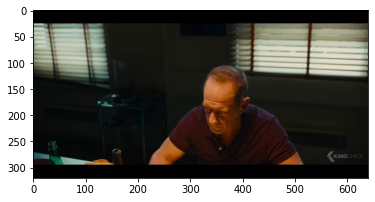

FastAI Plán eredmény: CU


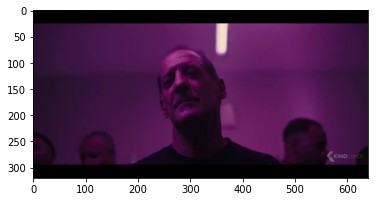

FastAI Plán eredmény: CU


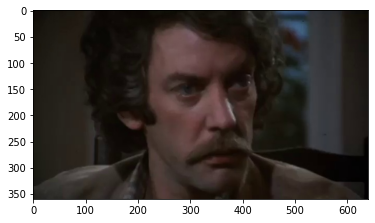

FastAI Plán eredmény: CU


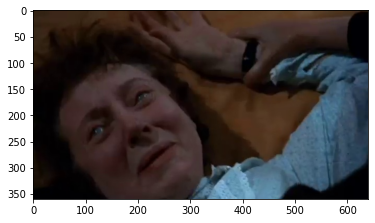

FastAI Plán eredmény: ML


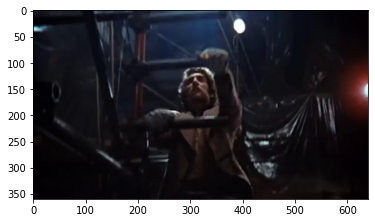

FastAI Plán eredmény: CU


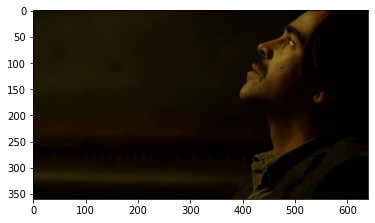

FastAI Plán eredmény: CU


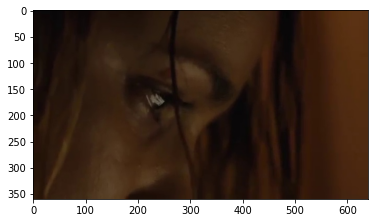

FastAI Plán eredmény: CU


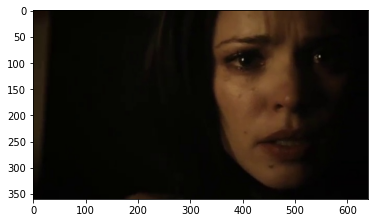

FastAI Plán eredmény: ML


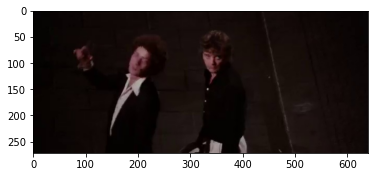

FastAI Plán eredmény: MC


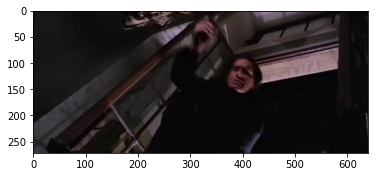

FastAI Plán eredmény: CU


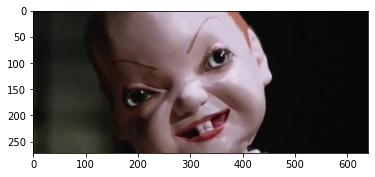

FastAI Plán eredmény: L


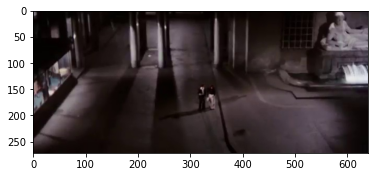

FastAI Plán eredmény: CU


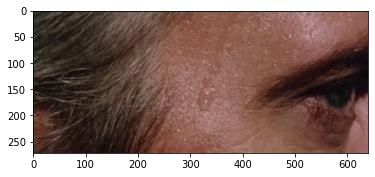

FastAI Plán eredmény: CU


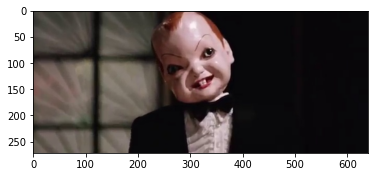

FastAI Plán eredmény: CU


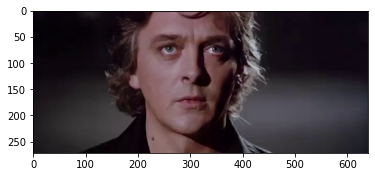

FastAI Plán eredmény: L


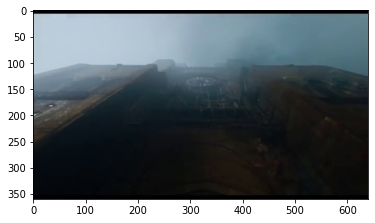

FastAI Plán eredmény: MC


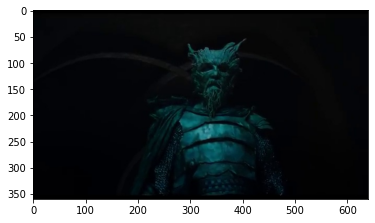

FastAI Plán eredmény: CU


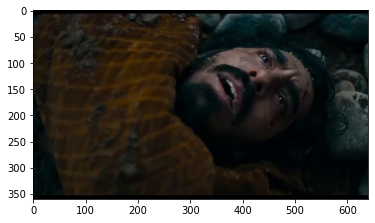

FastAI Plán eredmény: CU


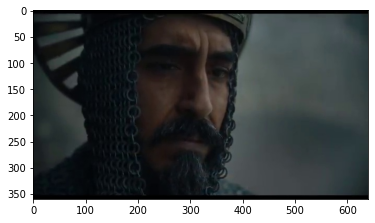

FastAI Plán eredmény: MC


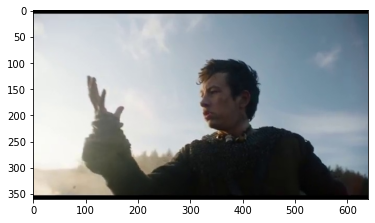

FastAI Plán eredmény: L


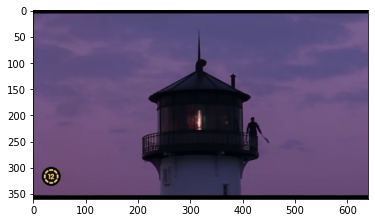

FastAI Plán eredmény: MC


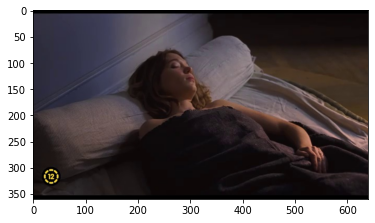

FastAI Plán eredmény: L


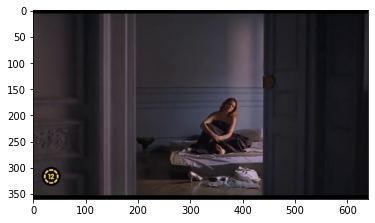

FastAI Plán eredmény: L


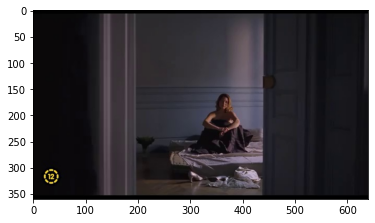

FastAI Plán eredmény: L


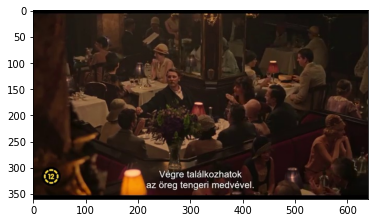

FastAI Plán eredmény: CU


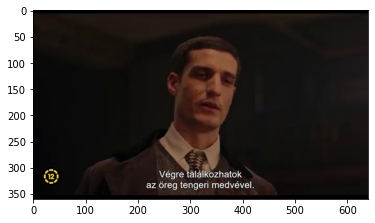

FastAI Plán eredmény: L


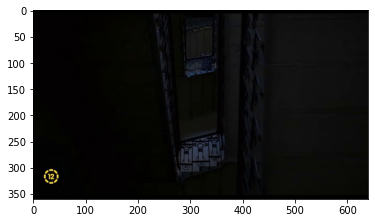

FastAI Plán eredmény: CU


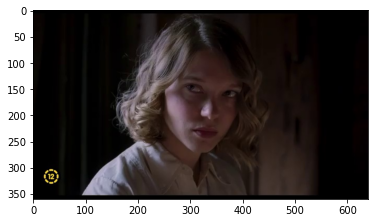

In [ ]:
for file in lst:
    img = open_image(file)
    #img.show(title = str(shot_type_fastai.predict(img)[0]))
    prediction1 = str(learn.predict(img)[0])
    fastai3_return.append(prediction1)
    print(f'FastAI Plán eredmény: {prediction1}')
    img_path=os.path.join(mappa,file)
    img_array=img = cv2.imread(img_path,cv2.COLOR_BGR2RGB)
    plt.imshow(cv2.cvtColor(img_array, cv2.COLOR_BGR2RGB))
    plt.show()


In [ ]:
import pandas as pd
df3 = pd.DataFrame(list(zip(lst,fastai3_return,solutions)), columns = ['Filename','Fast.AI Prediction','Correct Answer'])
df3['Correct Answer'] =  df3['Correct Answer'].str[0]
df3['Score'] = df3['Fast.AI Prediction'] == df2['Correct Answer']
df3['Score'] = df3['Score'].astype(int)


df3

,Filename,Fast.AI Prediction,Correct Answer,Score
0,./Pretty.Woman.1990.720p.BluRay.x264.YIFY-Scen...,CU,CU,1
1,./Pretty.Woman.1990.720p.BluRay.x264.YIFY-Scen...,MC,ML,0
2,./bo.burnham.inside.2021.720p.web.h264-naisu-S...,MC,CU,0
3,./bo.burnham.inside.2021.720p.web.h264-naisu-S...,CU,CU,1
4,./bo.burnham.inside.2021.720p.web.h264-naisu-S...,CU,MC,0
...,...,...,...,...
144,./FeleségemTörténete-Scene-017-01.jpg,L,L,1
145,./FeleségemTörténete-Scene-019-03.jpg,L,L,1
146,./FeleségemTörténete-Scene-020-01.jpg,CU,CU,1
147,./FeleségemTörténete-Scene-034-01.jpg,L,L,1


In [ ]:
model_score3 = df3['Score'].sum()
all_images3 = len(df3['Score'])
endresult3 = model_score3/all_images3

print(f'Accuracy = {endresult3 * 100}%')
# Note: The new model scored worse compared to the previous, therefore it is not exported.

Accuracy = 75.16778523489933%
